# 2.0 - Data Processing
## Testing with 0.9 variance from PCA

In [3]:
import sys
sys.path.append('..')

import pandas as pd
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt

label_encoder = LabelEncoder()

In [4]:
df = pd.read_csv("../data/processed/kddcup_data_preprocessed.csv")
df.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,srv_diff_host_rate,dst_host_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_srv_serror_rate,dst_host_srv_rerror_rate,label,attack_type
0,0,tcp,http,SF,181,5450,0,0,0,0,...,0.0,9,1.0,0.0,0.11,0.0,0.0,0.0,normal,normal
1,0,tcp,http,SF,239,486,0,0,0,0,...,0.0,19,1.0,0.0,0.05,0.0,0.0,0.0,normal,normal
2,0,tcp,http,SF,235,1337,0,0,0,0,...,0.0,29,1.0,0.0,0.03,0.0,0.0,0.0,normal,normal
3,0,tcp,http,SF,219,1337,0,0,0,0,...,0.0,39,1.0,0.0,0.03,0.0,0.0,0.0,normal,normal
4,0,tcp,http,SF,217,2032,0,0,0,0,...,0.0,49,1.0,0.0,0.02,0.0,0.0,0.0,normal,normal


In [5]:
df_categorical = df.select_dtypes(exclude=['int64', 'float64'])
categorical_cols = df_categorical.columns.to_list()
categorical_cols

['protocol_type', 'service', 'flag', 'label', 'attack_type']

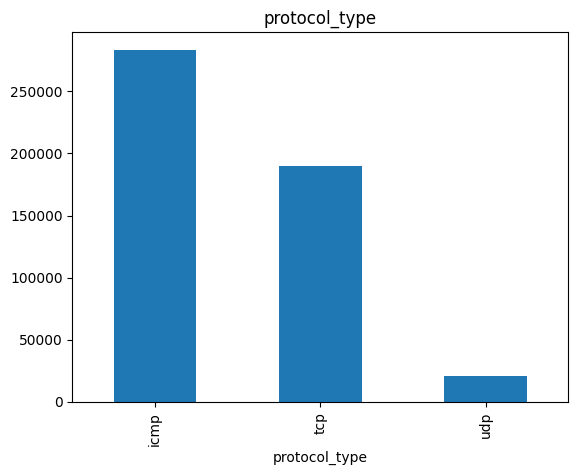

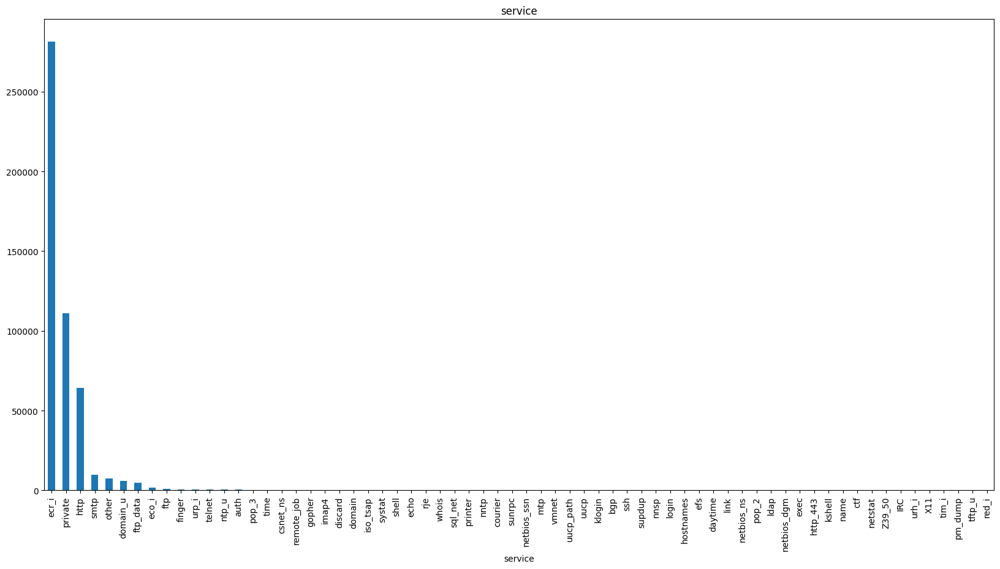

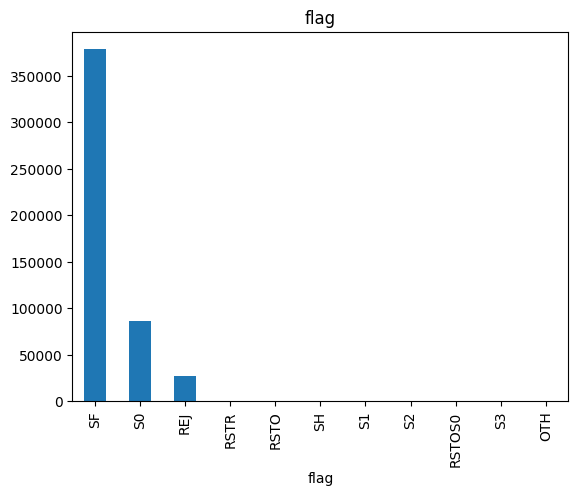

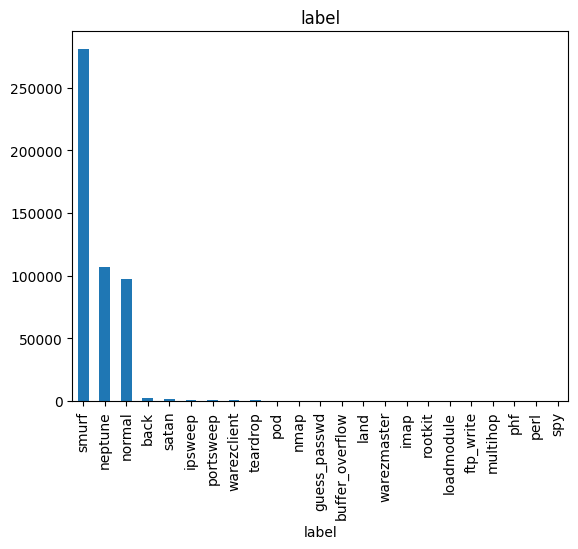

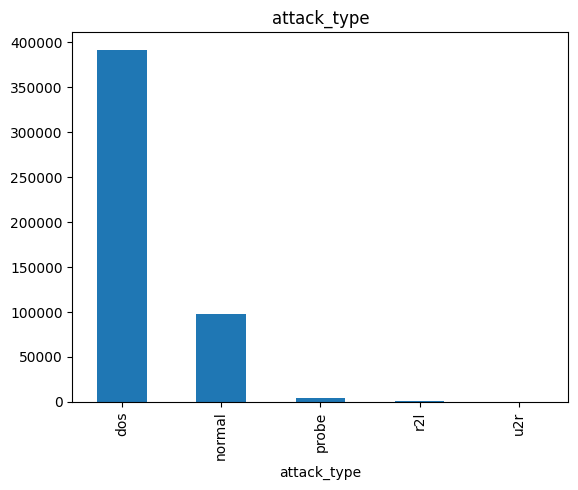

In [6]:
for col in categorical_cols:
    if col == "service":
        plt.figure(figsize=(20, 10))
    df[col].value_counts().plot(kind='bar', title=col)
    plt.show()

In [7]:
for col in categorical_cols:
    if col == "attack_type" or col == "label":
        continue
    df[col] = label_encoder.fit_transform(df[col])
    
df.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,srv_diff_host_rate,dst_host_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_srv_serror_rate,dst_host_srv_rerror_rate,label,attack_type
0,0,1,22,9,181,5450,0,0,0,0,...,0.0,9,1.0,0.0,0.11,0.0,0.0,0.0,normal,normal
1,0,1,22,9,239,486,0,0,0,0,...,0.0,19,1.0,0.0,0.05,0.0,0.0,0.0,normal,normal
2,0,1,22,9,235,1337,0,0,0,0,...,0.0,29,1.0,0.0,0.03,0.0,0.0,0.0,normal,normal
3,0,1,22,9,219,1337,0,0,0,0,...,0.0,39,1.0,0.0,0.03,0.0,0.0,0.0,normal,normal
4,0,1,22,9,217,2032,0,0,0,0,...,0.0,49,1.0,0.0,0.02,0.0,0.0,0.0,normal,normal


---

In [8]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.manifold import TSNE
from sklearn.decomposition import TruncatedSVD, PCA

import umap

import plotly.express as px

scaler = StandardScaler()

In [9]:
df.drop(columns=["label"], inplace=True)
X = df.drop(columns=["attack_type"])
y = df["attack_type"]

In [10]:
X_scaled = scaler.fit_transform(X)

In [11]:
# svd = TruncatedSVD(n_components=7)
pca = PCA()
pca_features = pca.fit_transform(X_scaled)
explained_variance = pca.explained_variance_ratio_
cum_sum_eigenvalues = np.cumsum(explained_variance)

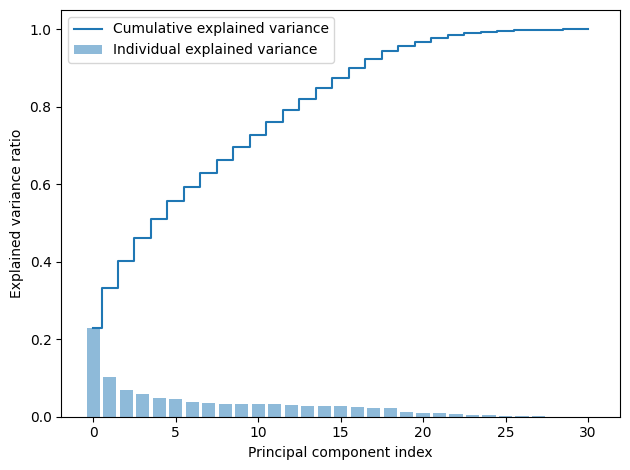

In [12]:
plt.bar(range(0,len(explained_variance)), explained_variance, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [13]:
selected_dimensions = pca_features[:, :17]
selected_dimensions.shape

(494021, 17)

---

In [15]:
px.scatter(x=selected_dimensions[:, 0], y=selected_dimensions[:, 1], color=y)

In [16]:
y.value_counts()

attack_type
dos       391458
normal     97278
probe       4107
r2l         1126
u2r           52
Name: count, dtype: int64

In [17]:
indices = []
np.random.seed(42)

for attack_type in y.unique():
    print(attack_type, y[y == attack_type].shape[0])
    if y[y == attack_type].shape[0] < 5000:
        print(f"attack_type: {attack_type} has less than 5000 samples -> using all samples")
        indices.extend(y[y == attack_type].index)
    else:
        indices.extend(np.random.choice(y[y == attack_type].index, 5000, replace=False))

# sanity check
px.bar(x=y[indices].value_counts().index,
       y=y[indices].value_counts().values)

normal 97278
u2r 52
attack_type: u2r has less than 5000 samples -> using all samples
dos 391458
r2l 1126
attack_type: r2l has less than 5000 samples -> using all samples
probe 4107
attack_type: probe has less than 5000 samples -> using all samples


In [18]:
X_reduced = X_scaled[indices]
y_reduced = y[indices]

In [19]:
umap_model = umap.UMAP(n_components=2)
umap_features = umap_model.fit_transform(X_reduced)
px.scatter(x=umap_features[:, 0], y=umap_features[:, 1], color=y_reduced)

/Users/ahmedosman/Documents/Projects/Network-Intrusion-Detection/venv/lib/python3.11/site-packages/sklearn/manifold/_spectral_embedding.py:301: UserWarning:

Graph is not fully connected, spectral embedding may not work as expected.



In [20]:
tsne = TSNE(n_components=2)
tsne_features = tsne.fit_transform(X_reduced)
px.scatter(x=tsne_features[:, 0], y=tsne_features[:, 1], color=y_reduced)

In [21]:
px.scatter(x=tsne_features[:, 0], y=tsne_features[:, 1], color=["attack" if x != "normal" else "normal" for x in y_reduced])

---

t-SNE + PCA

In [23]:
X_reduced.shape

(15285, 31)

In [27]:
selected_dimensions[indices, :17].shape

(15285, 17)

In [29]:
tsne = TSNE(n_components=2)
tsne_features = tsne.fit_transform(selected_dimensions[indices, :13])
px.scatter(x=tsne_features[:, 0], y=tsne_features[:, 1], color=y_reduced)

In [33]:
df.to_csv("../data/processed/kddcup_data_processed.csv", index=False)